In [1]:
import base64
import collections
import copy
import datetime
import itertools
import json
import math
import os
import operator
import pickle
import random
import re
import shutil
import sys
import time

import Image
import keras
from keras import *
from keras.preprocessing import image
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import PIL as pil
import pylab
import scipy
import seaborn as sns
import sklearn
from sklearn import *
import statsmodels as sm
import tensorflow as tf


np.random.seed(1337)

%matplotlib inline

sns.set(font_scale=1.3)
mpl.rcParams['figure.figsize'] = 20, 12
sns.set_style('whitegrid')
sns.set_palette(sns.color_palette('muted'))

linewidth = 1.0
dotsize = 15

Using TensorFlow backend.
/usr/local/lib/python2.7/dist-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)
/usr/local/lib/python2.7/dist-packages/sklearn/grid_search.py:43: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. This module will be removed in 0.20.
  DeprecationWarning)
/usr/local/lib/python2.7/dist-packages/sklearn/lda.py:6: DeprecationWarning: lda.LDA has been moved to discriminant_analysis.LinearDiscriminantAnalysis in 0.17 and will be removed in 0.19
  "in 0.17 and will be removed in 0.19", DeprecationWarning)
/usr/lo

# Visualizing Intermediate Activations

In [2]:
model = keras.models.load_model('cats_and_dogs_small_2.h5')
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 15, 15, 128)       147584    
__________

In [3]:
from keras.preprocessing import image

img_path = '/home/csizsek/projects/deep-learning-with-python/data/catsdogs_small/test/cats/cat.1700.jpg'

# We preprocess the image into a 4D tensor
img = image.load_img(img_path, target_size=(150, 150))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)

# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.
# Its shape is (1, 150, 150, 3)

print(img_tensor.shape)

(1, 150, 150, 3)


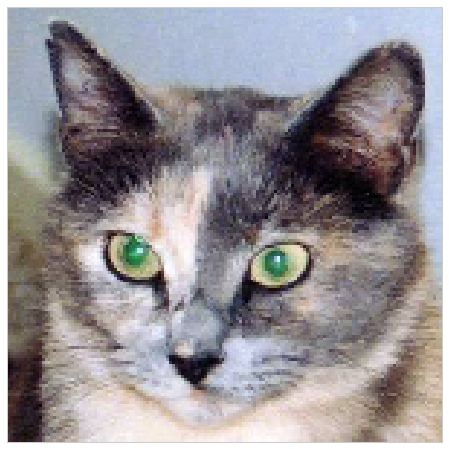

In [10]:
_ = plt.figure(figsize=(8, 8))
ax = plt.imshow(img_tensor[0])
plt.grid(None)
_ = ax.axes.xaxis.set_ticks([])
_ = ax.axes.yaxis.set_ticks([])

In [5]:
# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[:8]]
# Creates a model that will return these outputs, given the model input:
activation_model = keras.models.Model(input=model.input, output=layer_outputs)

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("co...)`
  after removing the cwd from sys.path.


In [6]:
# This will return a list of 5 Numpy arrays:
# one array per layer activation
activations = activation_model.predict(img_tensor)

In [9]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 148, 148, 32)


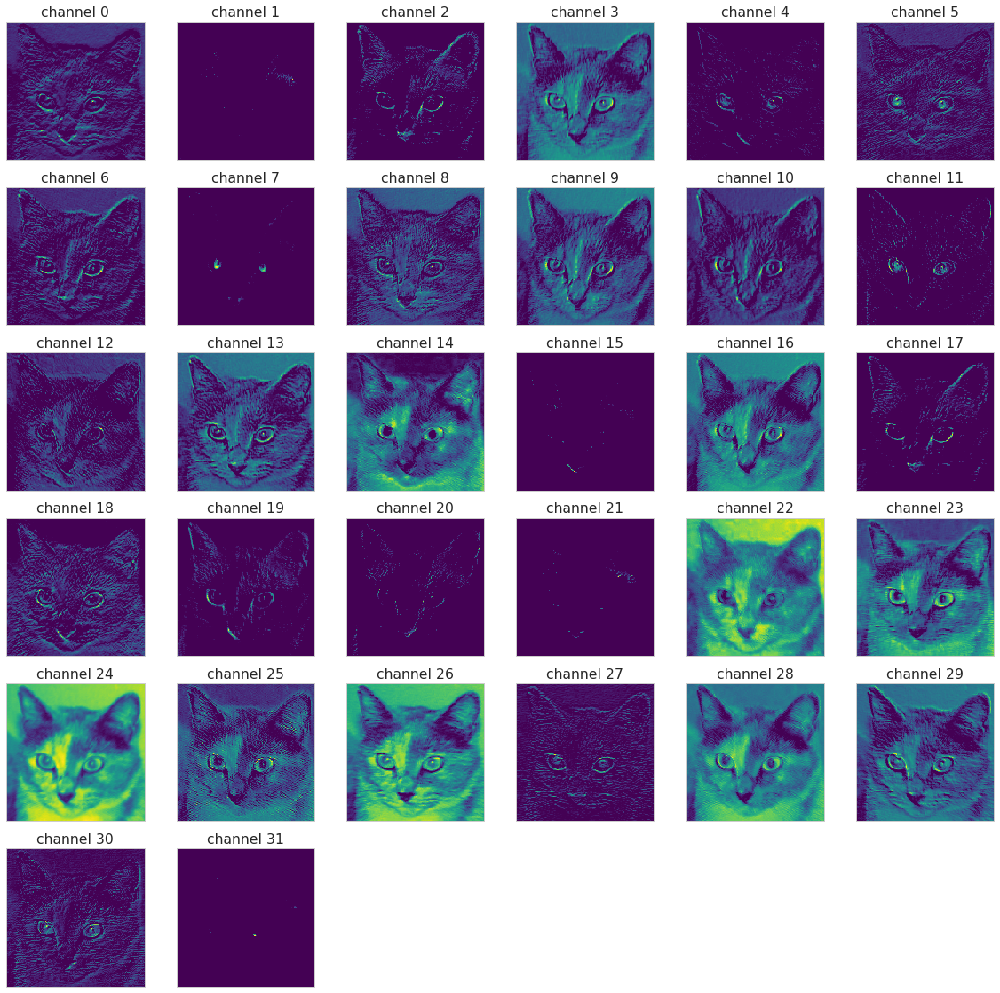

In [26]:
_ = plt.figure(figsize=(20, 20))
for i in range(first_layer_activation.shape[3]):
    plt.subplot(6, 6, i+1)
    ax = plt.imshow(first_layer_activation[0, :, :, i], cmap='viridis')
    plt.grid(None)
    _ = ax.axes.xaxis.set_ticks([])
    _ = ax.axes.yaxis.set_ticks([])
    _ = plt.title('channel {0}'.format(i))

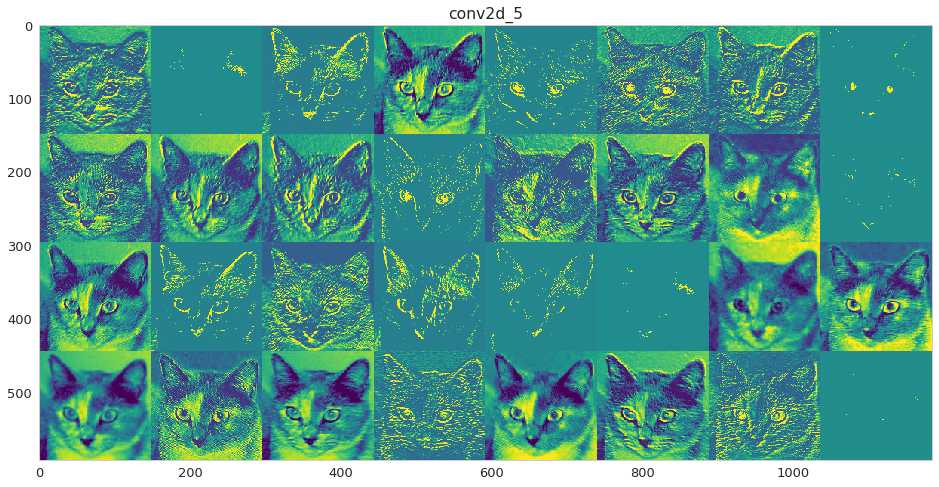

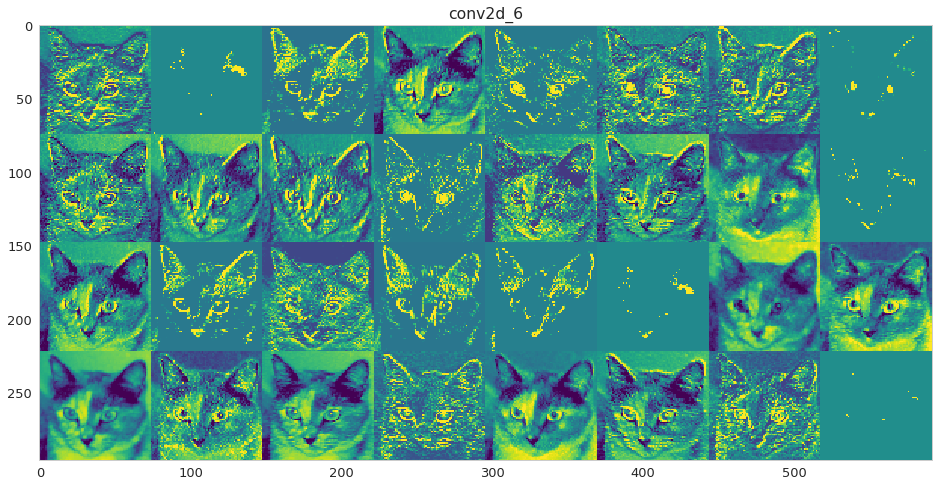

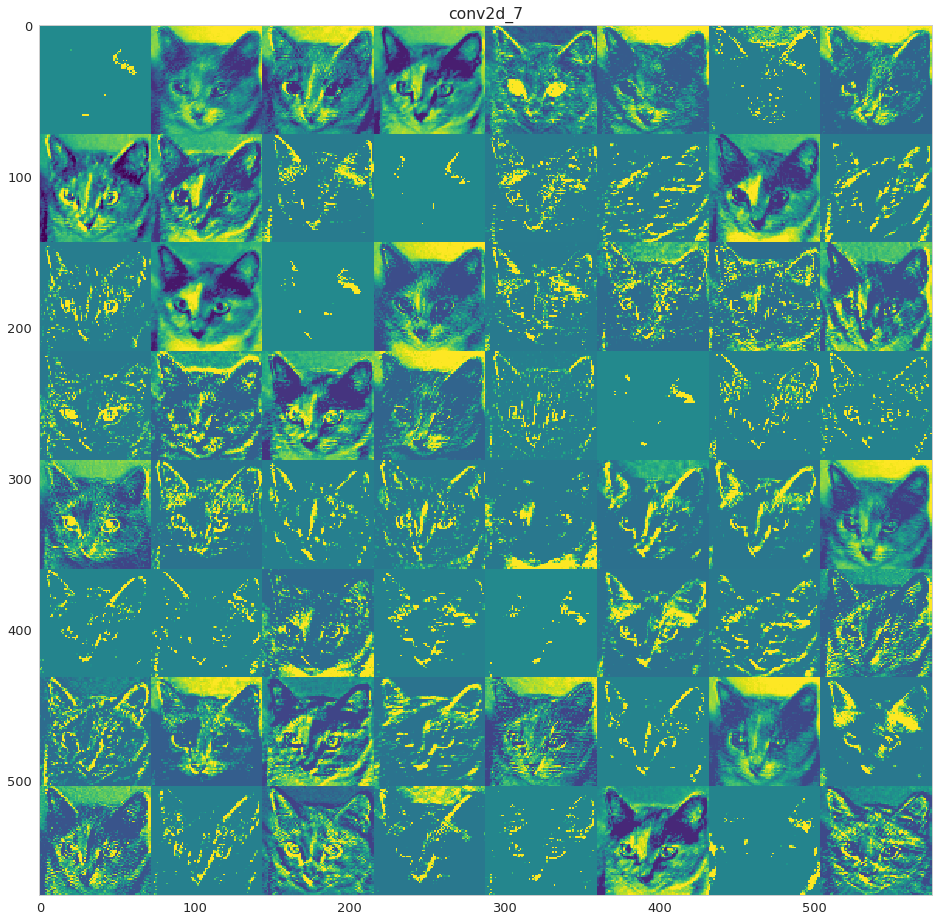

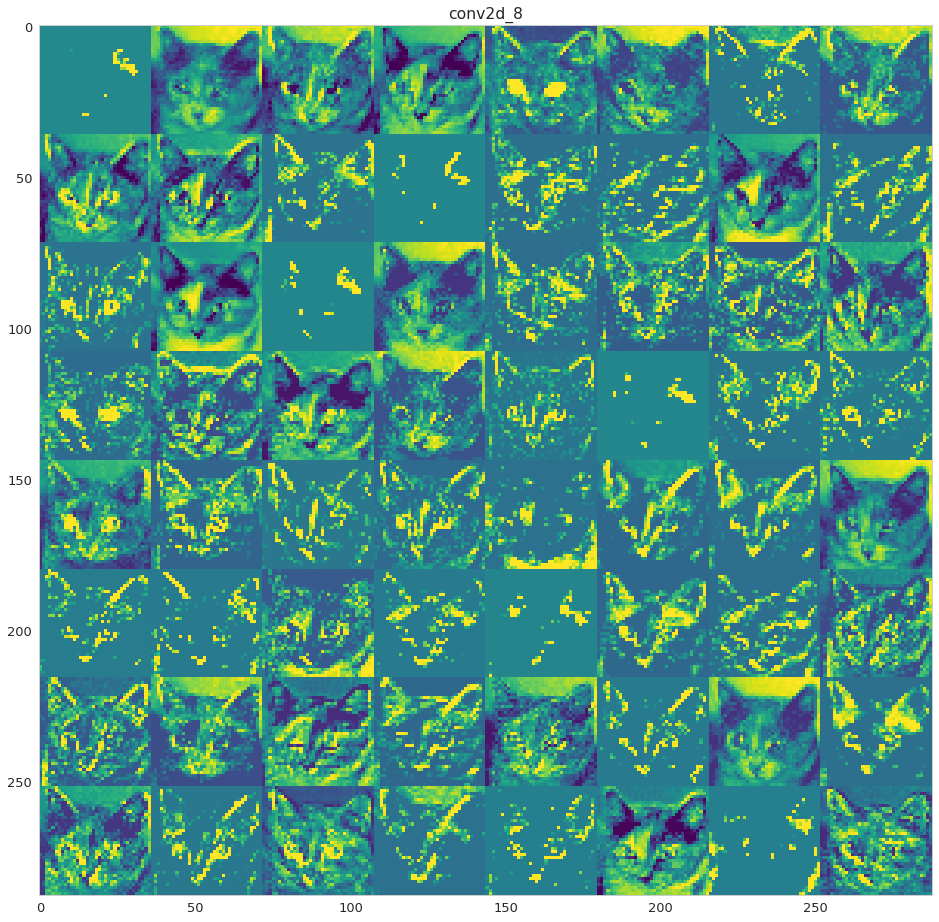

In [30]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []

for layer in model.layers[:8]:
    if isinstance(layer, layers.Conv2D):
        layer_names.append(layer.name)

images_per_row = 8
    
# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]
    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]
    # We will tile the activation channels in this matrix
    n_cols = n_features / images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :, col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 2. / size
    plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Visualizing ConvNet Filters

In [116]:
model = keras.applications.VGG16(
                weights='imagenet',
                include_top=False,
                input_shape=(150, 150, 3))
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
__________

In [117]:
layer_name = 'block1_conv1'
filter_index = 0
layer_output = model.get_layer(layer_name).output
loss = keras.backend.mean(layer_output[:, :, :, filter_index])

In [118]:
# The call to `gradients` returns a list of tensors (of size 1 in this case)
# hence we only keep the first element -- which is a tensor.
grads = keras.backend.gradients(loss, model.input)[0]

In [119]:
# We add 1e-5 before dividing so as to avoid accidentally dividing by 0.
grads /= (keras.backend.sqrt(keras.backend.mean(keras.backend.square(grads))) + 1e-5)

In [120]:
iterate = keras.backend.function([model.input], [loss, grads])

# Let's test it:
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [121]:
# we start from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.

# run gradient ascent for 40 steps
step = 1. # this is the magnitude of each gradient update
for i in range(40):
    # compute the loss value and gradient value
    loss_value, grads_value = iterate([input_img_data])
    
    # here we adjust the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

In [122]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    
    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)
    
    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    
    return x

In [123]:
def generate_pattern(layer_name, filter_index, size=150):
    
    # build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = model.get_layer(layer_name).output
    loss = keras.backend.mean(layer_output[:, :, :, filter_index])
    
    # compute the gradient of the input picture wrt this loss
    grads = keras.backend.gradients(loss, model.input)[0]
    
    # normalization trick: we normalize the gradient
    grads /= (keras.backend.sqrt(keras.backend.mean(keras.backend.square(grads))) + 1e-5)
    
    # this function returns the loss and grads given the input picture
    iterate = keras.backend.function([model.input], [loss, grads])
    
    # we start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    
    # run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        img = input_img_data[0]
        
    return deprocess_image(img)

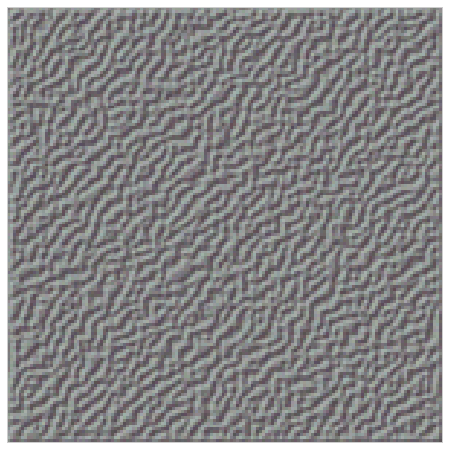

In [124]:
_ = plt.figure(figsize=(8, 8))
ax = plt.imshow(generate_pattern('block1_conv1', 0))
plt.grid(None)
_ = ax.axes.xaxis.set_ticks([])
_ = ax.axes.yaxis.set_ticks([])

In [148]:
def plot_channels(layer_name):
    size = 150
    margin = 5
    i_max = 4
    j_max = 4
    n_channels = int(model.get_layer(layer_name).output.shape[3])
    channels = range(n_channels)
    random.shuffle(channels)
    channels = channels[:16]

    # this a empty (black) image where we will store our results.
    results = np.zeros((i_max * size + (i_max - 1) * margin, j_max * size + (j_max - 1) * margin, 3))
    for i in range(i_max): # iterate over the rows of our results grid
        for j in range(j_max): # iterate over the columns of our results grid
            # generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, channels[i*4 + j], size=size)
            # put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # display the results grid
    _ = plt.figure(figsize=(20, 20))
    ax = plt.imshow(results)
    plt.grid(None)
    _ = ax.axes.xaxis.set_ticks([])
    _ = ax.axes.yaxis.set_ticks([])

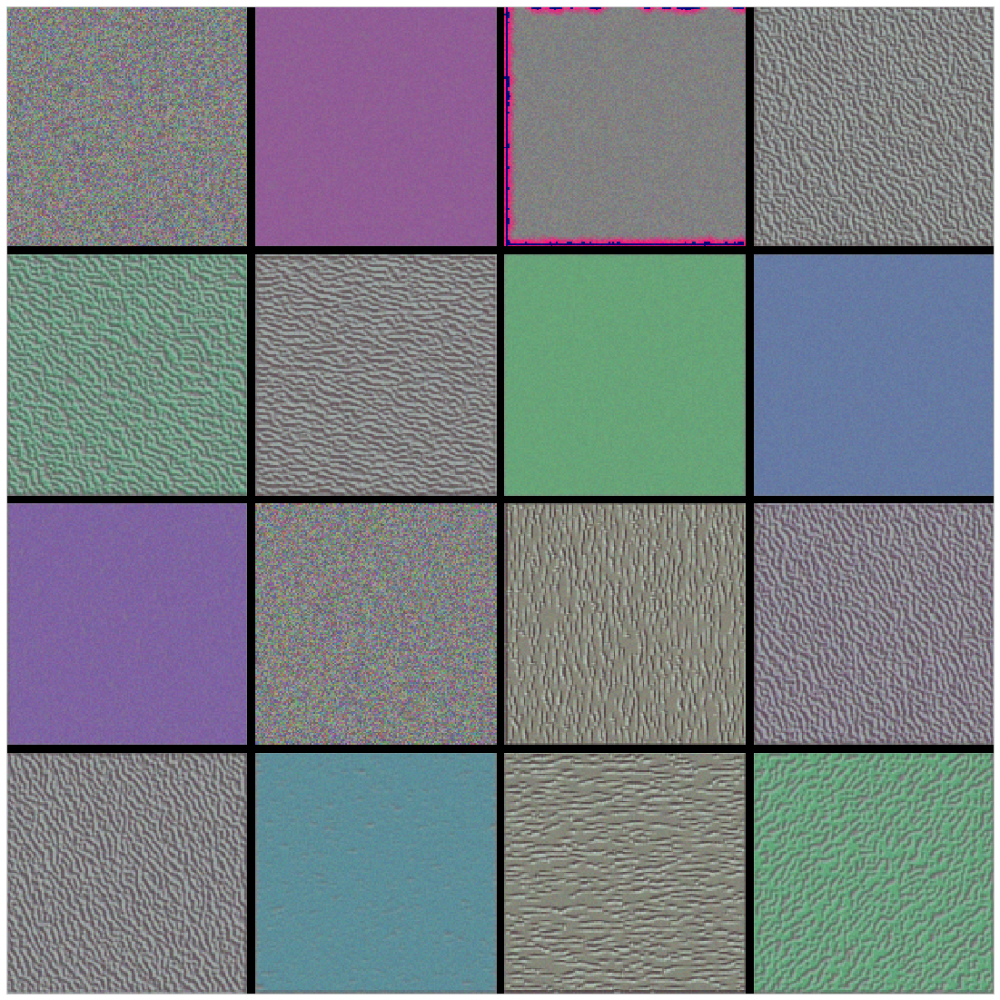

In [149]:
plot_channels('block1_conv1')

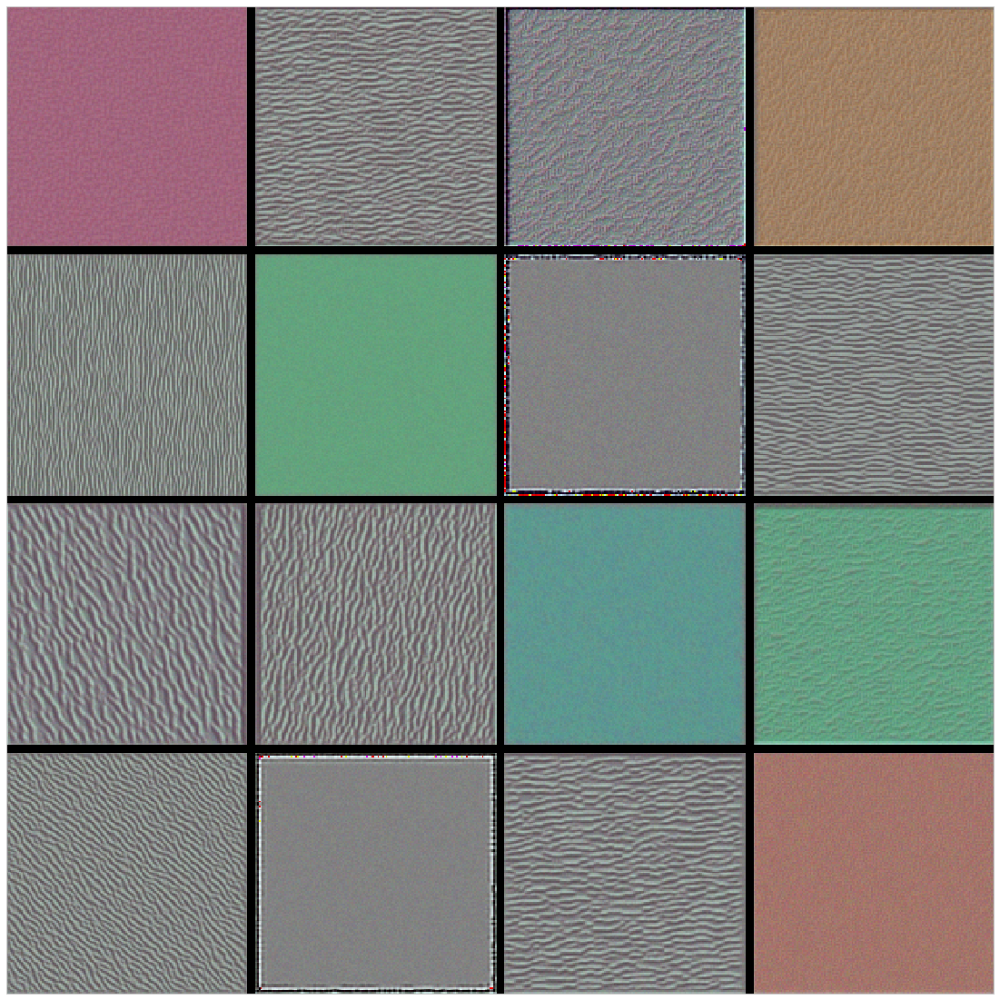

In [150]:
plot_channels('block1_conv2')

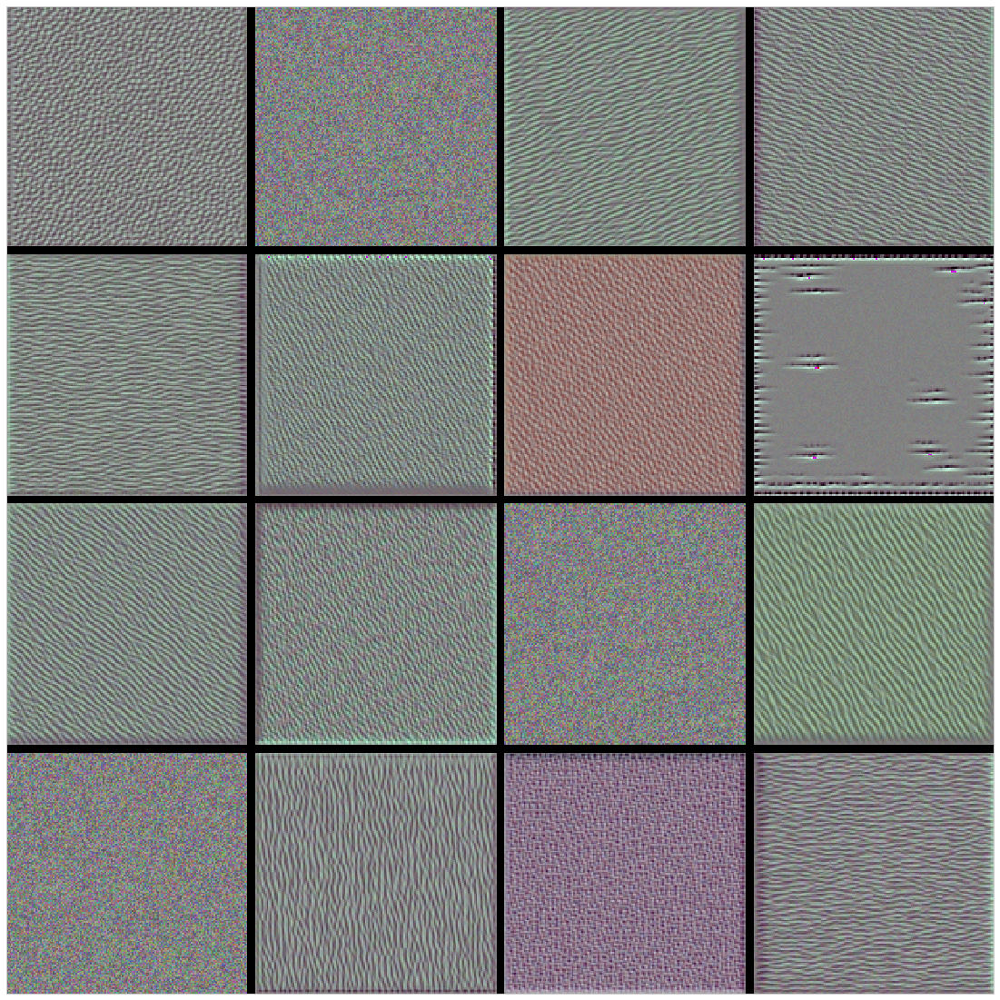

In [151]:
plot_channels('block2_conv1')

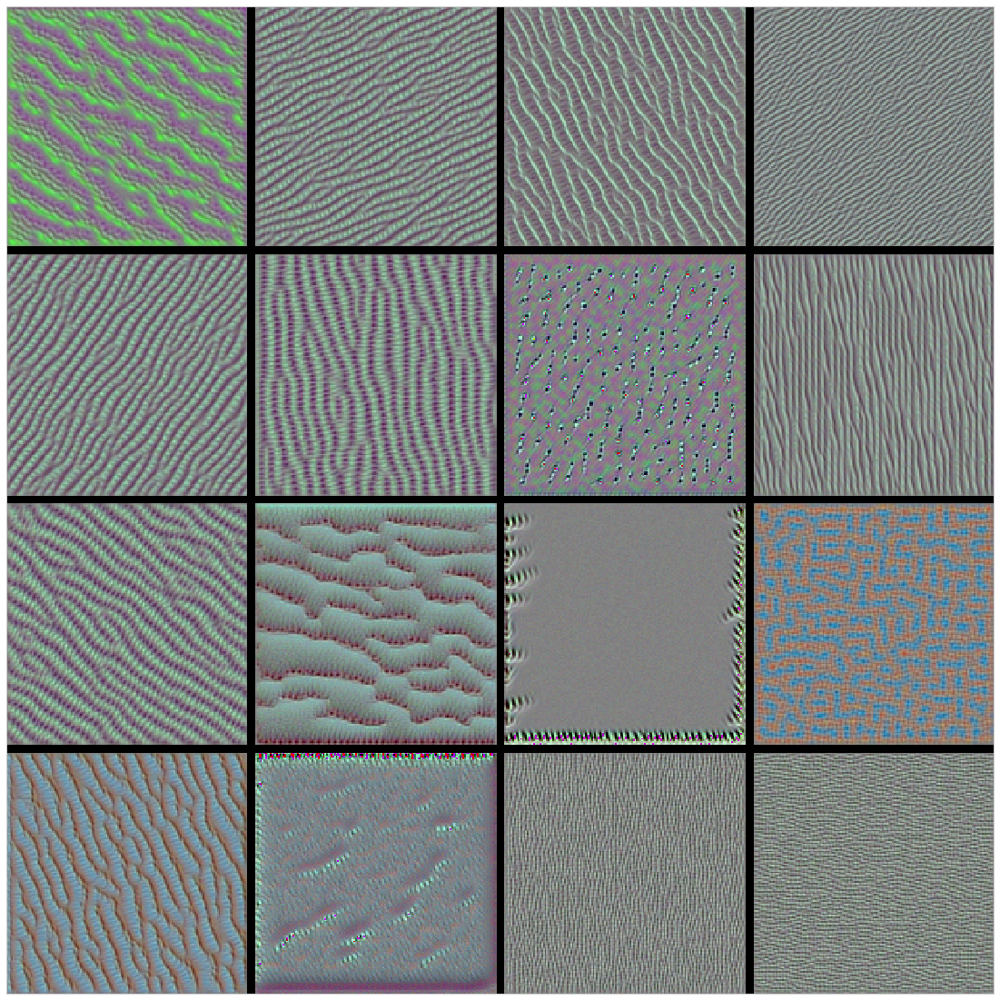

In [152]:
plot_channels('block2_conv2')

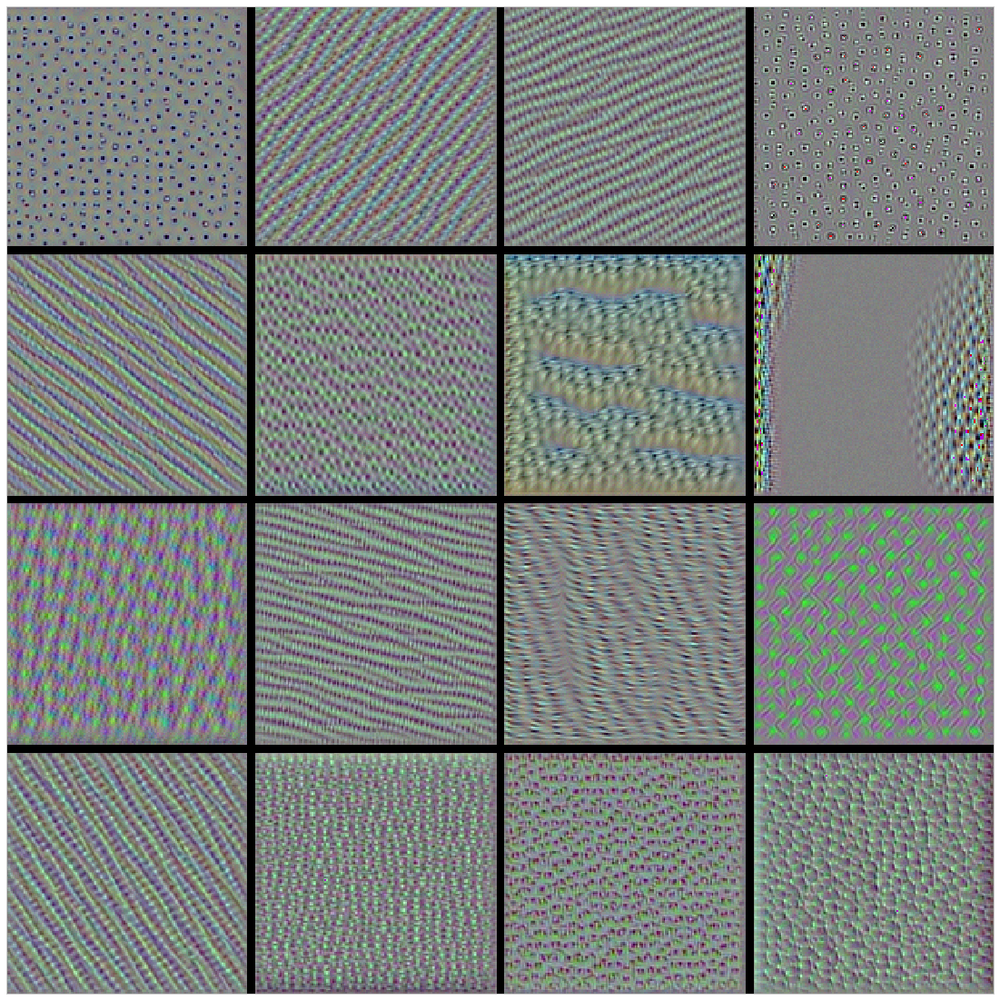

In [153]:
plot_channels('block3_conv1')

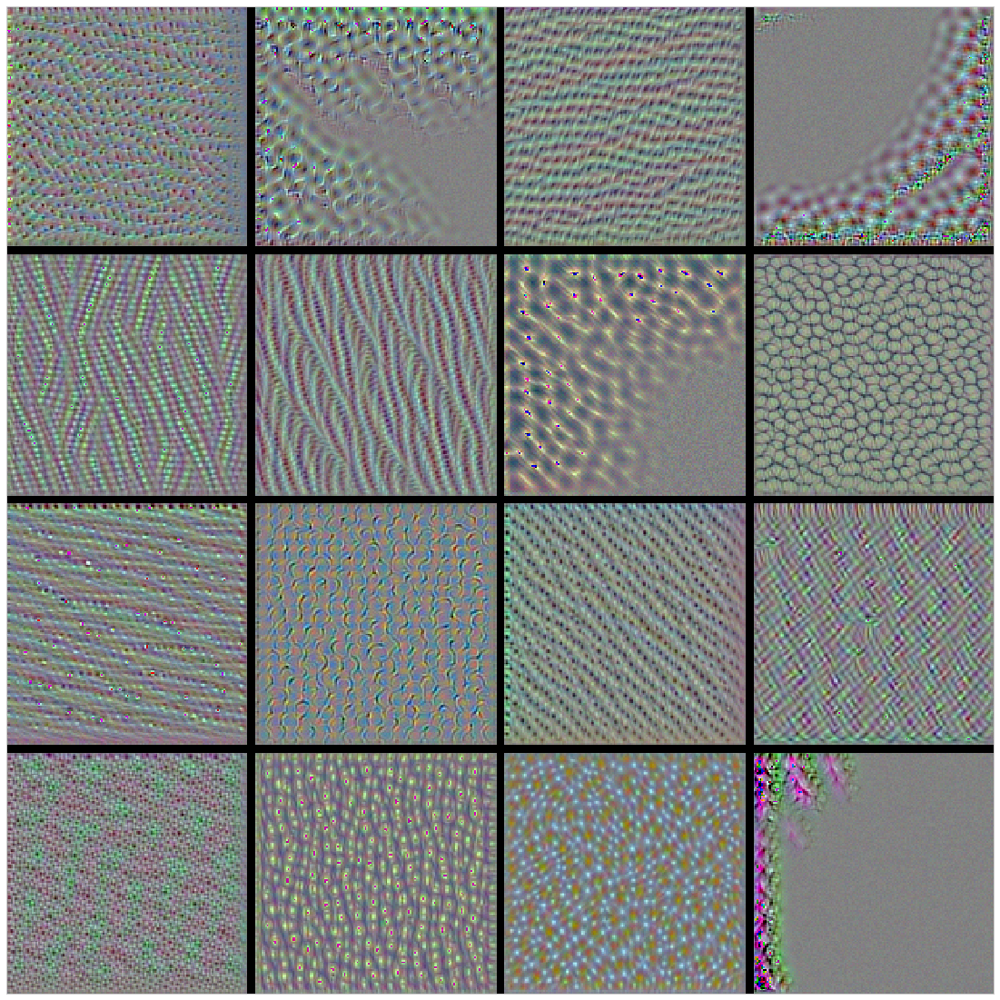

In [154]:
plot_channels('block3_conv2')

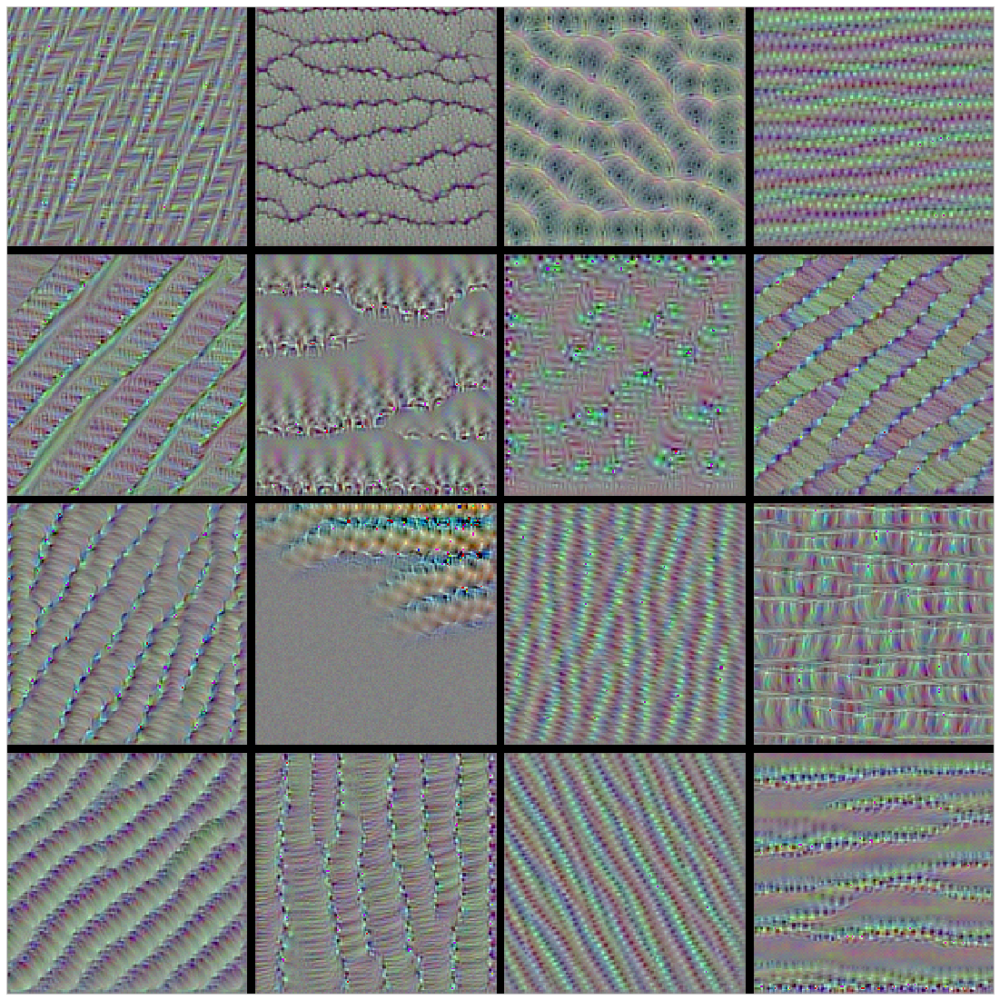

In [155]:
plot_channels('block3_conv3')

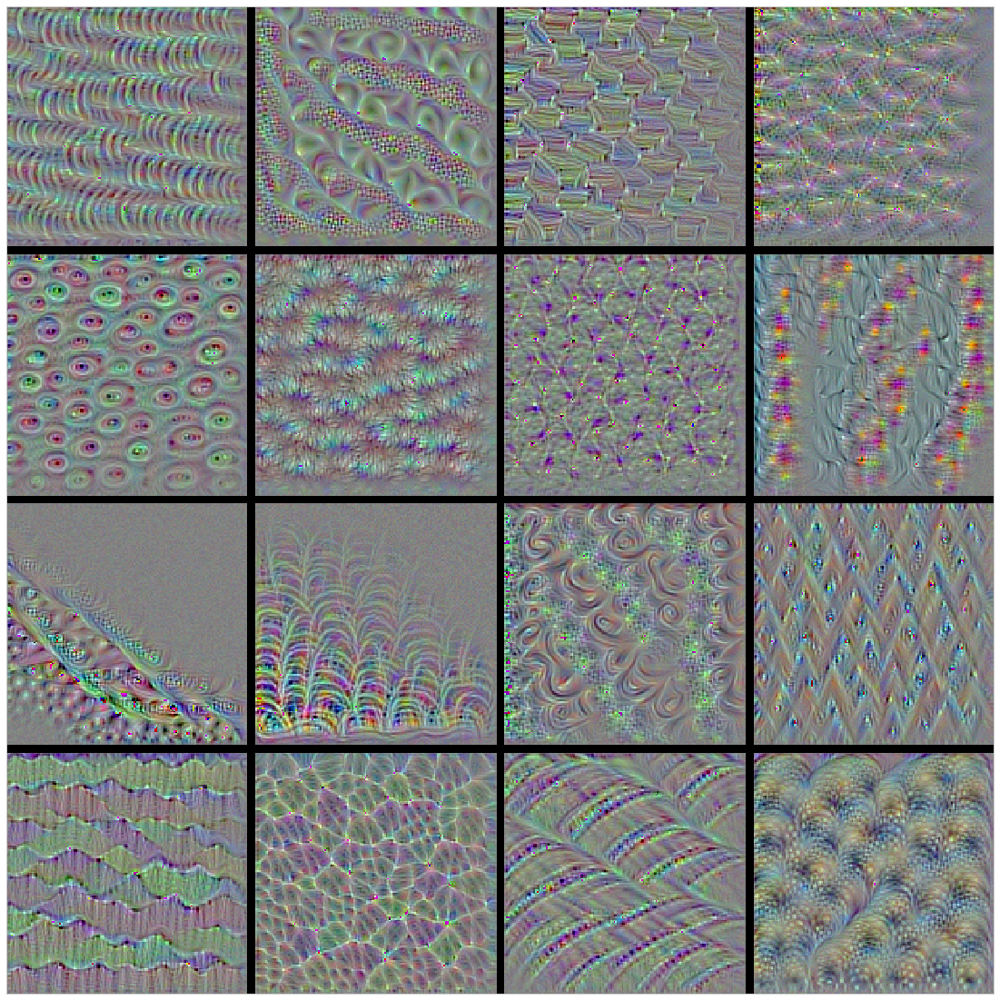

In [156]:
plot_channels('block4_conv1')

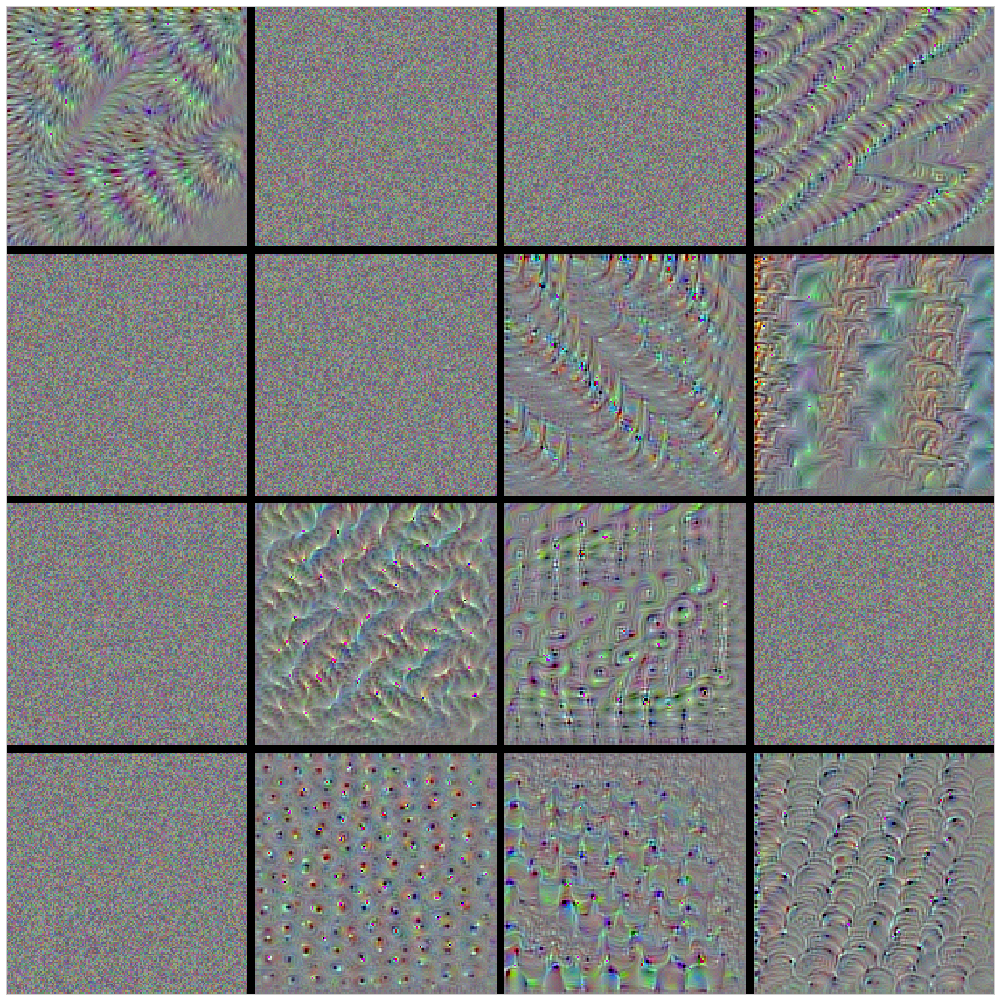

In [157]:
plot_channels('block4_conv2')

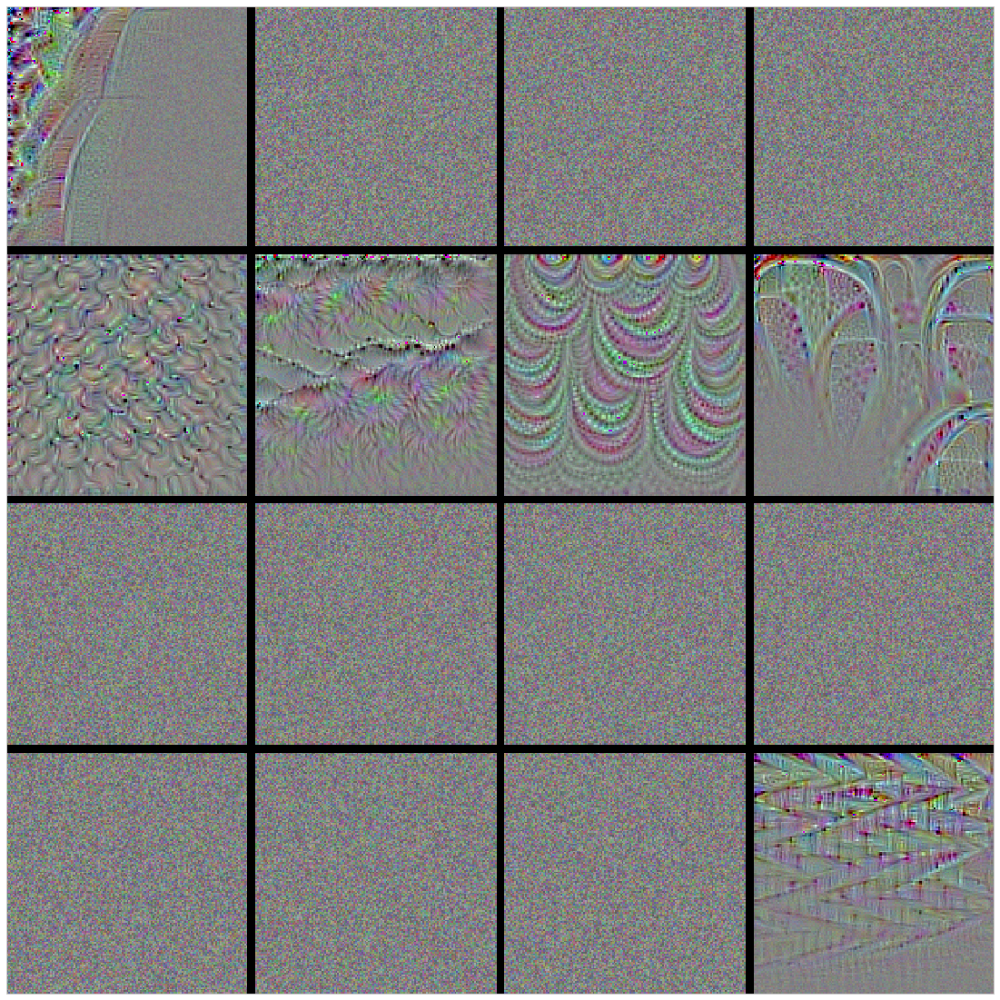

In [158]:
plot_channels('block4_conv3')

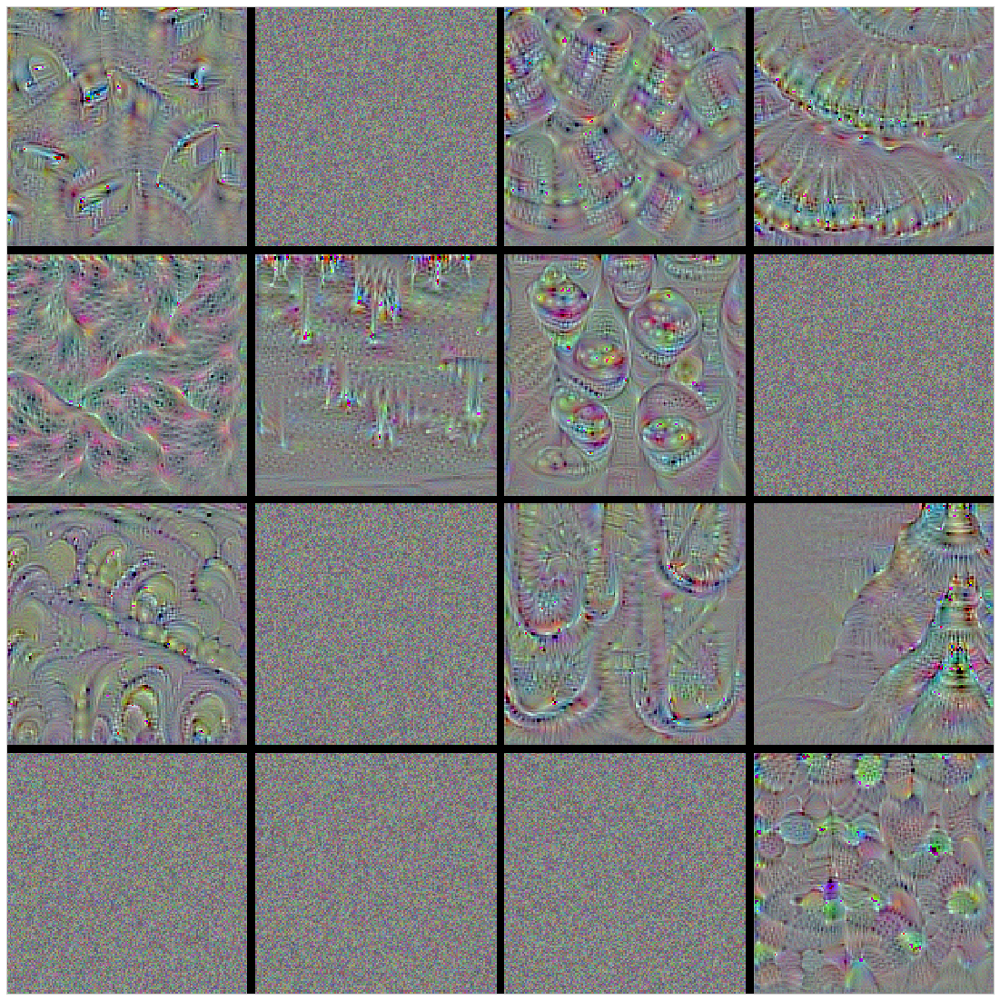

In [159]:
plot_channels('block5_conv1')

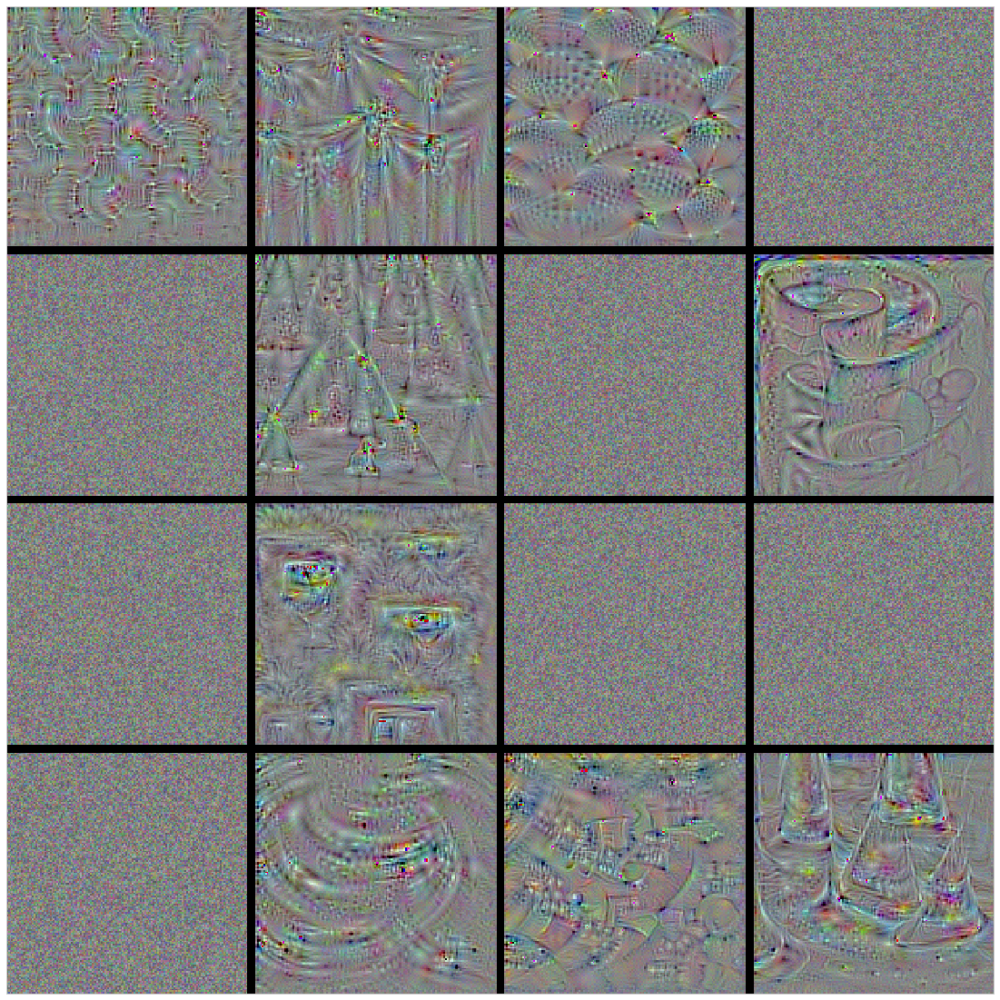

In [160]:
plot_channels('block5_conv2')

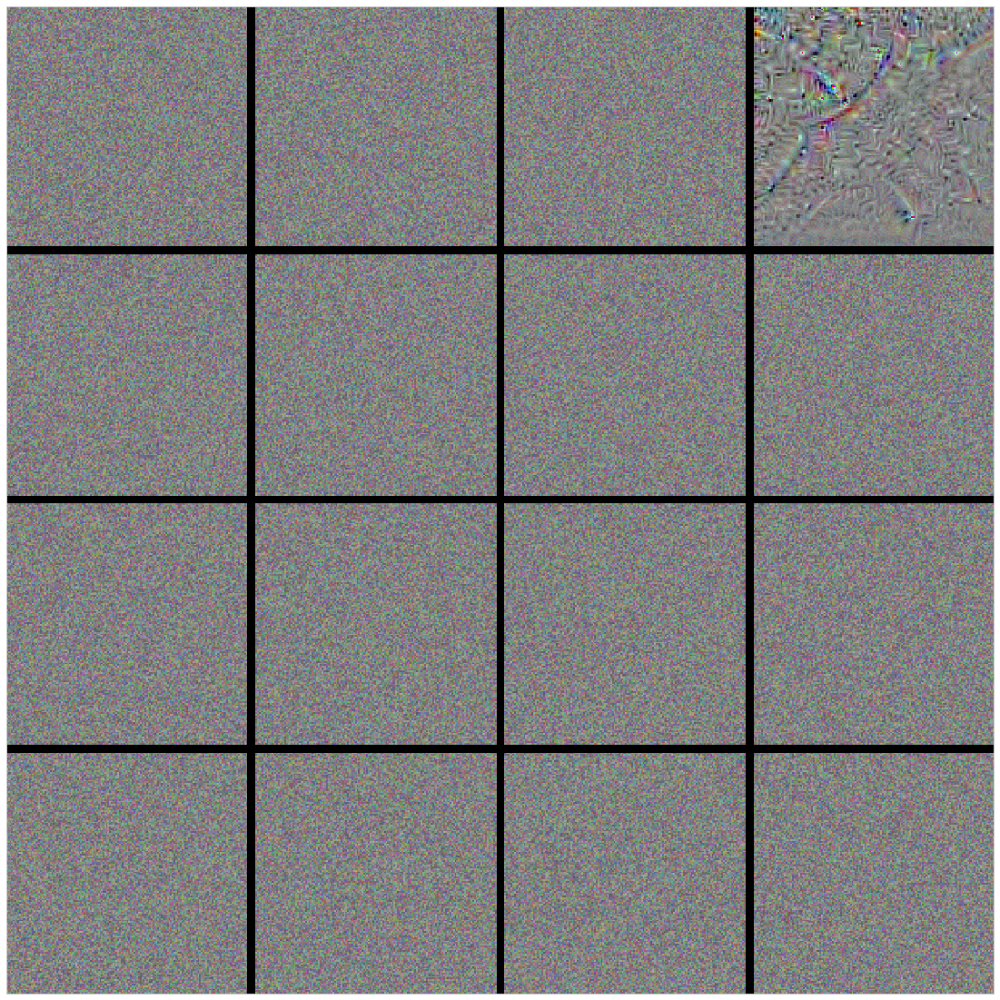

In [161]:
plot_channels('block5_conv3')

# Visualizing Heatmaps of Class Activation

In [231]:
from keras.applications.vgg16 import VGG16
model = VGG16(weights='imagenet')

In [232]:
from keras.applications.vgg16 import preprocess_input, decode_predictions
import numpy as np

# the local path to our target image
img_path = '/home/csizsek/projects/deep-learning-with-python/data/elephant.jpg'

# `img` is a PIL image of size 224x224
img = image.load_img(img_path, target_size=(224, 224))

# `x` is a float32 Numpy array of shape (224, 224, 3)
x = image.img_to_array(img)

# we add a dimension to transform our array into a "batch"
# of size (1, 224, 224, 3)
x = np.expand_dims(x, axis=0)

# finally we preprocess the batch
# (this does channel-wise color normalization)
x = preprocess_input(x)

In [233]:
preds = model.predict(x)
print('Predicted:', decode_predictions(preds, top=3)[0])

('Predicted:', [(u'n02504458', u'African_elephant', 0.75219101), (u'n01871265', u'tusker', 0.22554693), (u'n02504013', u'Indian_elephant', 0.022165481)])


In [234]:
np.argmax(preds[0])

386

In [235]:
# this is the "african elephant" entry in the prediction vector
african_elephant_output = model.output[:, 386]
# the is the output feature map of the `block5_conv3` layer,
# the last convolutional layer in VGG16
last_conv_layer = model.get_layer('block5_conv3')
# this is the gradient of the "african elephant" class with regard to
# the output feature map of `block5_conv3`
grads = keras.backend.gradients(african_elephant_output, last_conv_layer.output)[0]
# this is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = keras.backend.mean(grads, axis=(0, 1, 2))
# this function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = keras.backend.function([model.input], [pooled_grads, last_conv_layer.output[0]])
# these are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([x])
# we multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(512):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
# the channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap = np.mean(conv_layer_output_value, axis=-1)

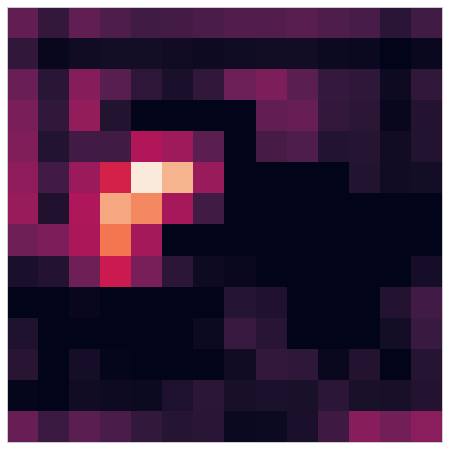

In [236]:
heatmap = np.maximum(heatmap, 0)
heatmap /= np.max(heatmap)
_ = plt.figure(figsize=(8, 8))
ax = plt.imshow(heatmap)
plt.grid(None)
_ = ax.axes.xaxis.set_ticks([])
_ = ax.axes.yaxis.set_ticks([])

In [237]:
import cv2

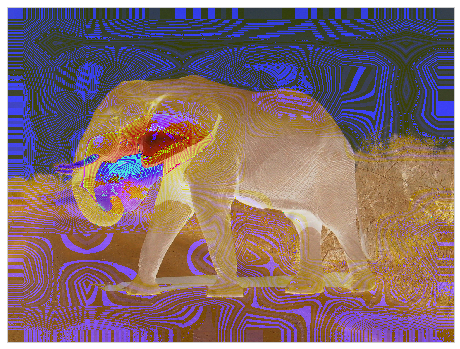

In [238]:
# we use cv2 to load the original image
img = cv2.imread(img_path)

# we resize the heatmap to have the same size as the original image
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

# we convert the heatmap to RGB
heatmap = np.uint8(255 * heatmap)

#print heatmap

# we apply the heatmap to the original image
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)

# 0.4 here is a heatmap intensity factor
superimposed_img = heatmap * 0.4 + img

_ = plt.figure(figsize=(8, 8))
ax = plt.imshow(superimposed_img)
plt.grid(None)
_ = ax.axes.xaxis.set_ticks([])
_ = ax.axes.yaxis.set_ticks([])